In [27]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

In [28]:
warnings.fㅁilterwarnings('ignore')

In [2]:
train = pd.read_csv('train_preprocessed.csv')
test = pd.read_csv('test_preprocessed.csv')

In [3]:
train['적정온도차이'] = train['기온(C)'] - 26
test['적정온도차이'] = test['기온(C)'] - 26

In [43]:
train.head()

,건물번호,기온(C),강수량(mm),풍속(m/s),습도(%),month,day,holiday,sin_time,cos_time,DI,power,적정온도차이
0,1,18.6,0.0,0.9,42.0,6,2,0,0.000000,1.000000,234.154,1085.28,-7.4
1,1,18.0,0.0,1.1,45.0,6,2,0,0.258819,0.965926,219.280,1047.36,-8.0
2,1,17.7,0.0,1.5,45.0,6,2,0,0.500000,0.866025,205.672,974.88,-8.3
3,1,16.7,0.0,1.4,48.0,6,2,0,0.707107,0.707107,167.011,953.76,-9.3
4,1,18.4,0.0,2.8,43.0,6,2,0,0.866025,0.500000,229.592,986.40,-7.6


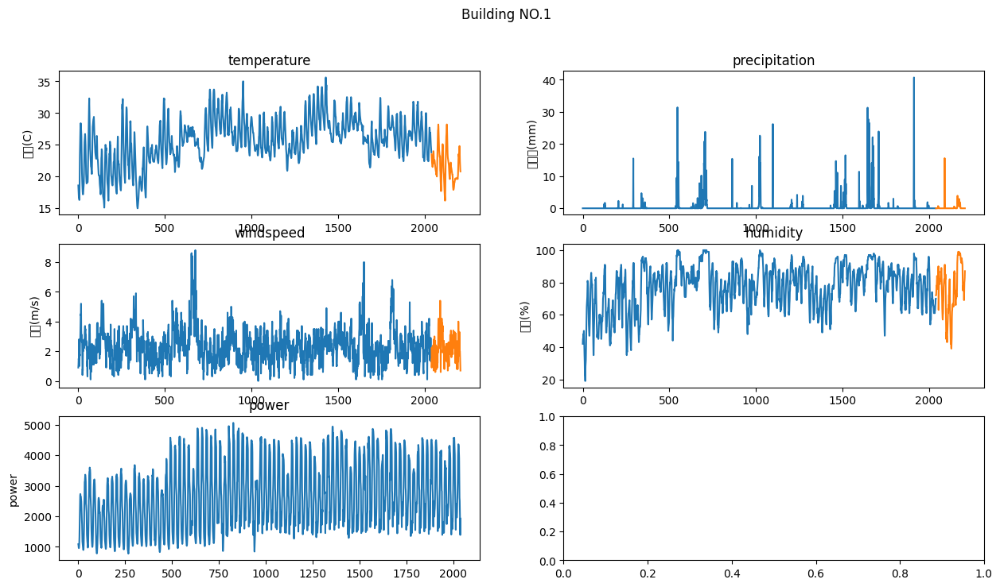

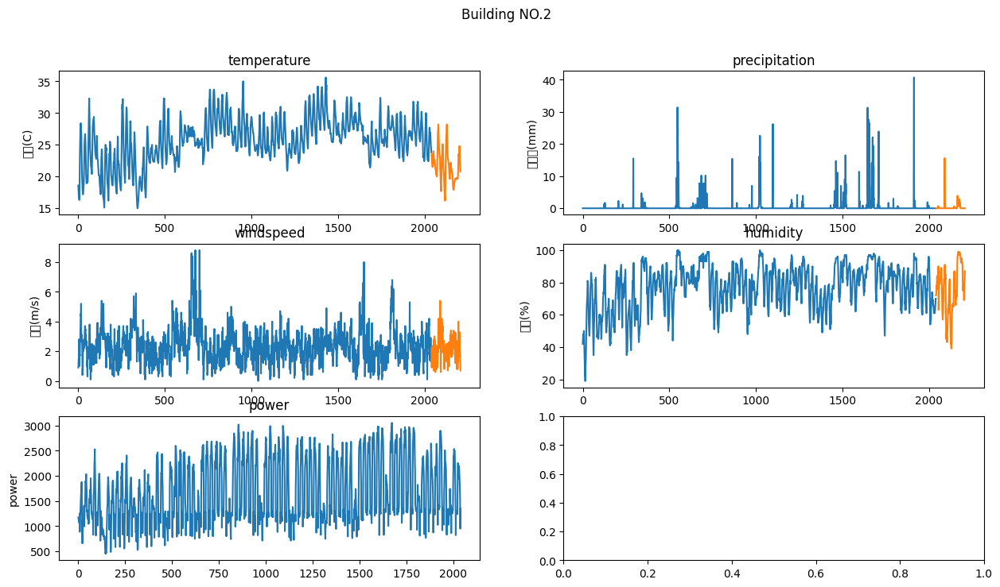

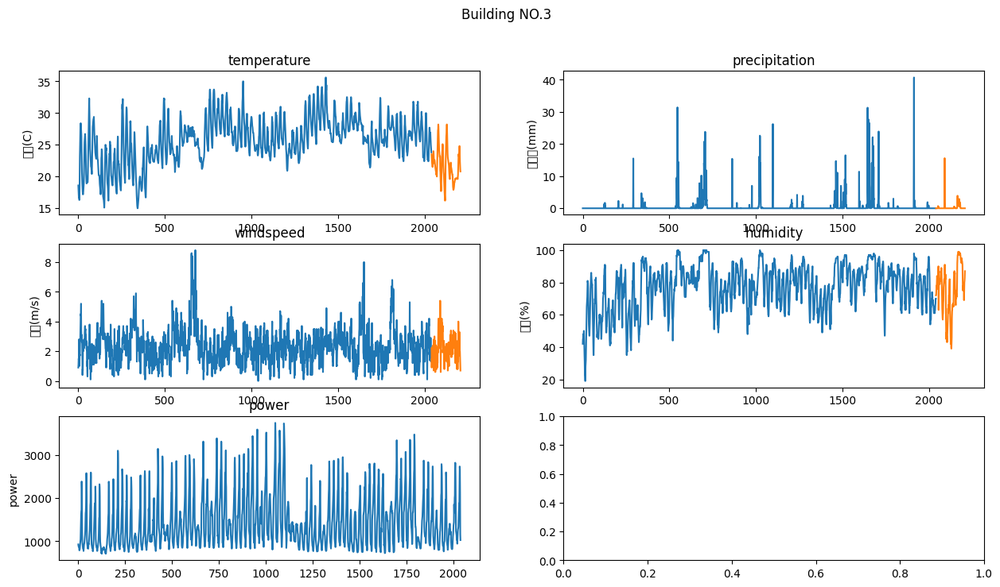

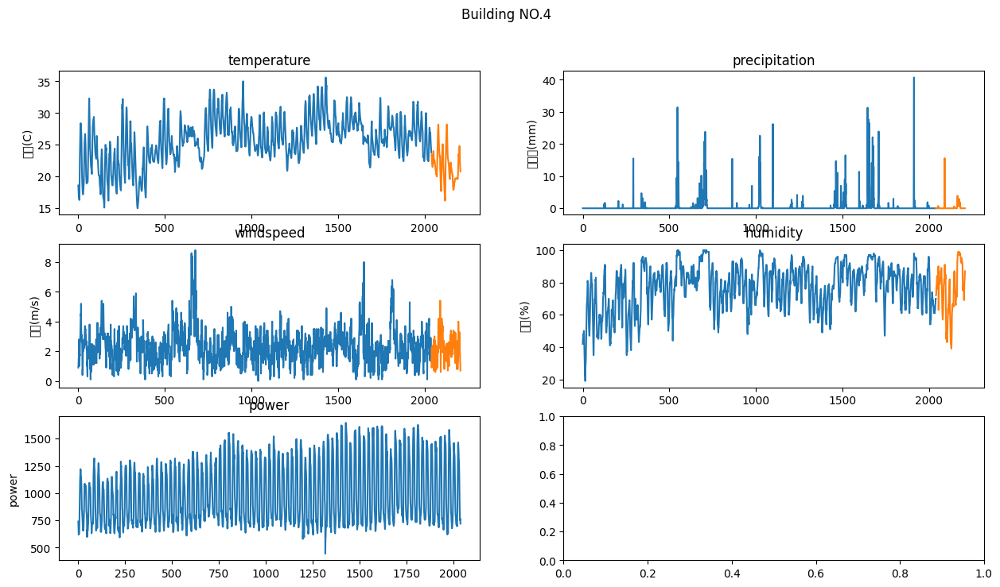

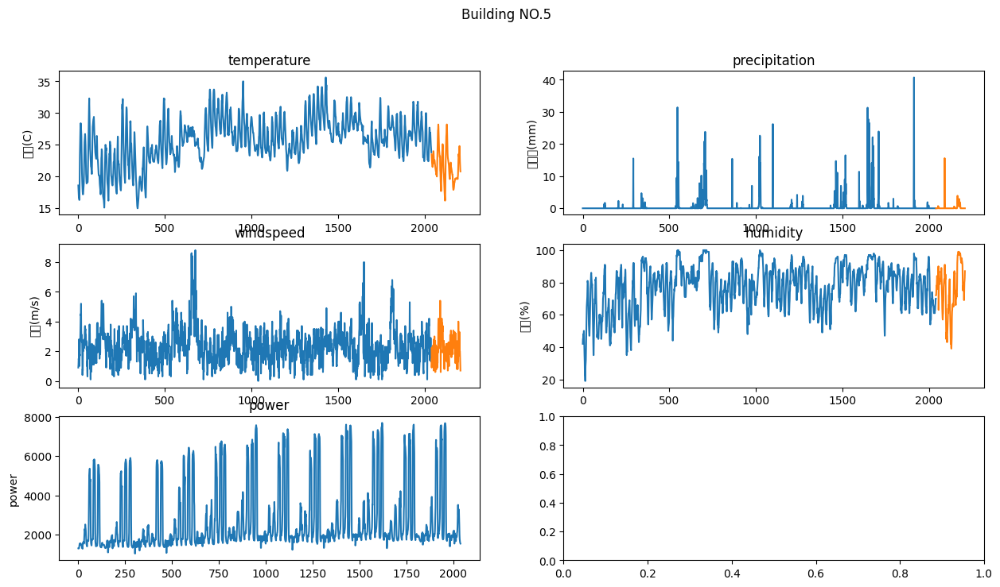

...

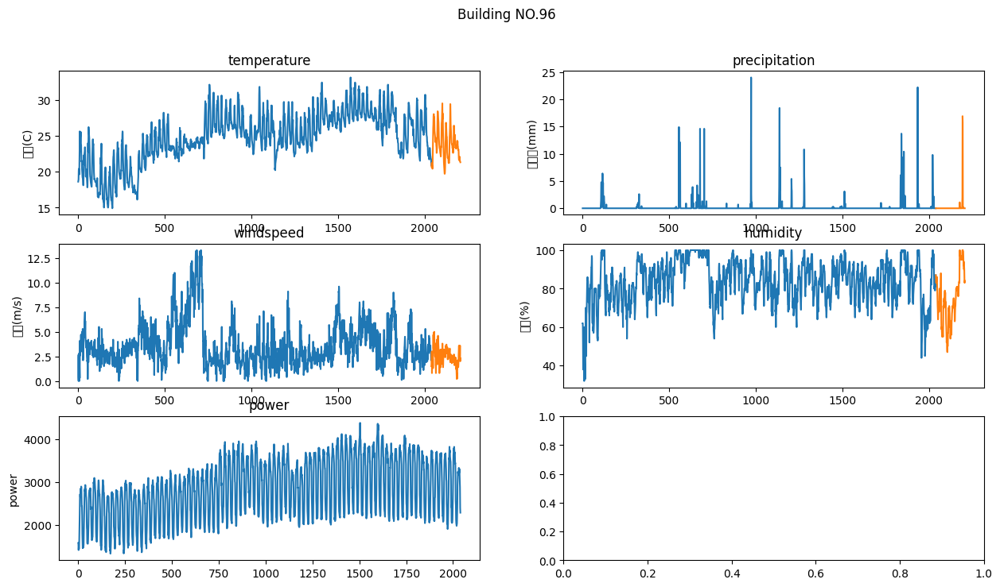

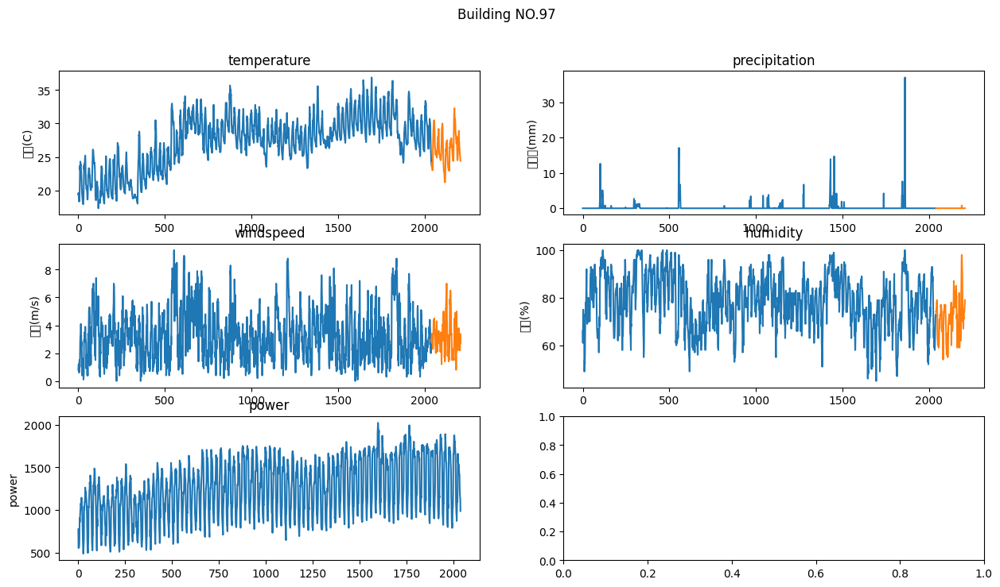

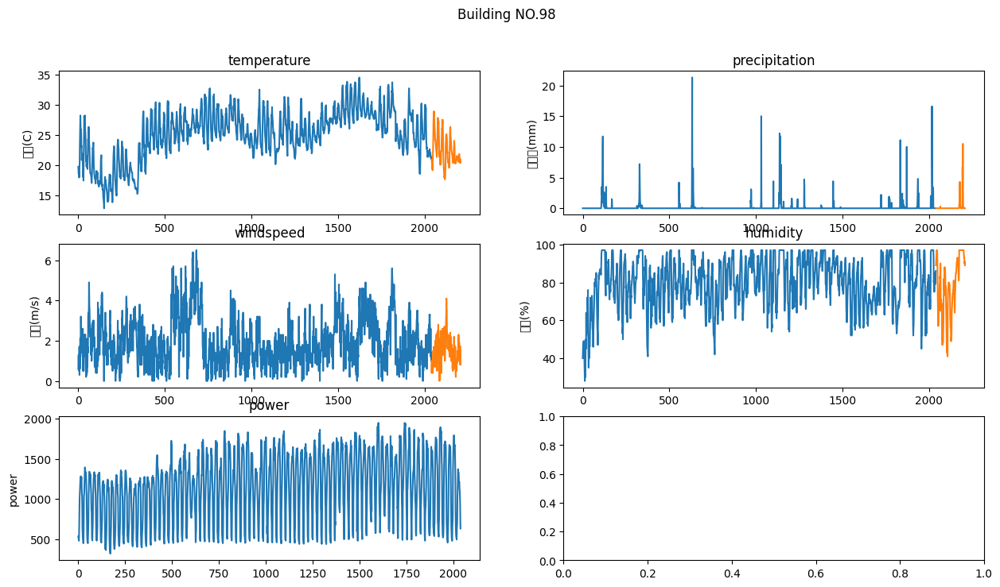

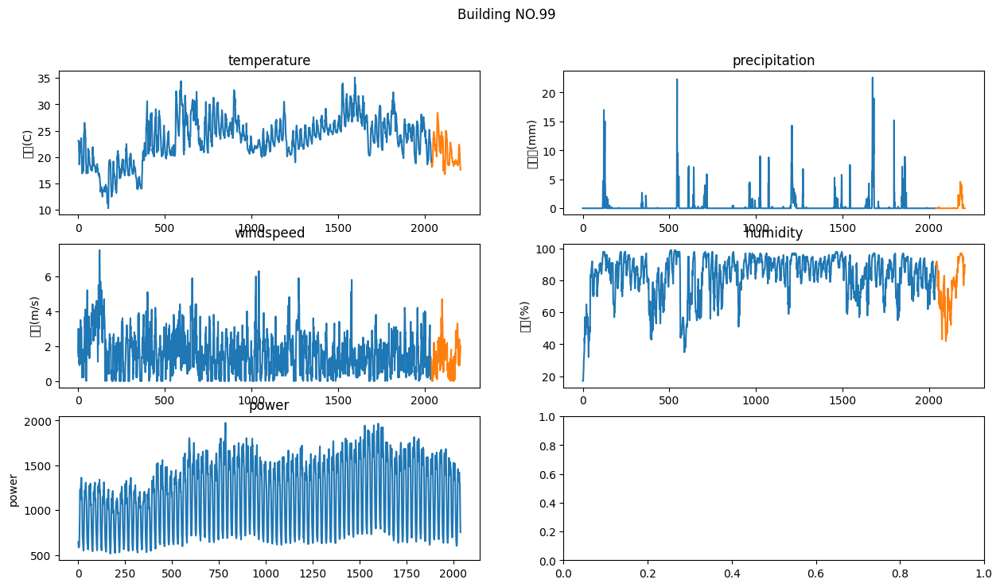

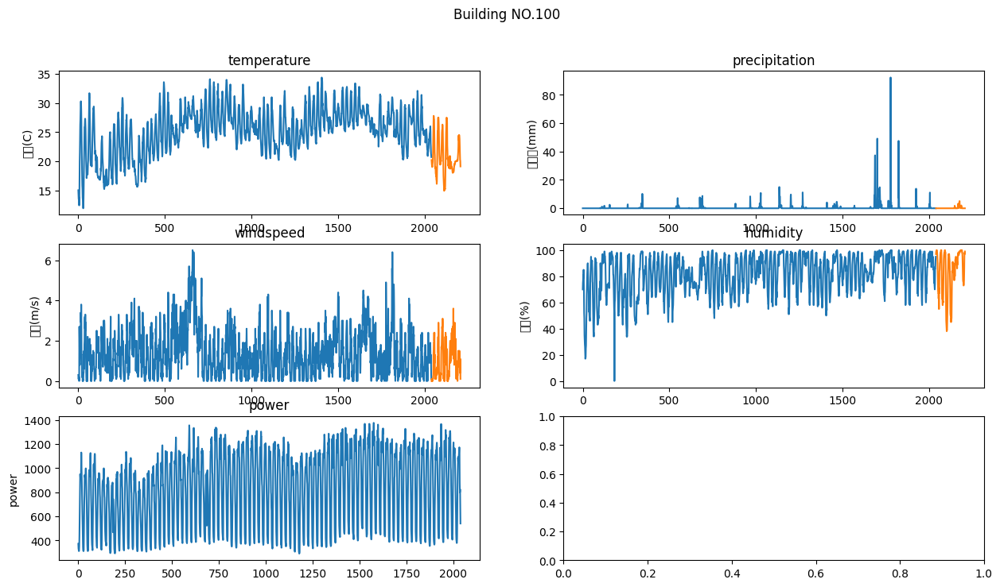

In [44]:
title_lst = ['temperature', 'precipitation', 'windspeed', 'humidity', 'power']

for i in range(100):
    fig, ax = plt.subplots(ncols=2, nrows=3, figsize=(15, 8))
    tr = train[train['건물번호']==i+1]
    ts = test[test['건물번호']==i+1]
    plt.suptitle(f'Building NO.{i+1}')
    row = 0
    col = 0
    for j in ['기온(C)', '강수량(mm)', '풍속(m/s)', '습도(%)', 'power']:
        sns.lineplot(x=range(len(tr)),
                     y=tr[j],
                     ax=ax[row, col])
        if j != 'power':
            sns.lineplot(x=range(len(tr), len(tr)+len(ts)),
                         y=ts[j],
                         ax=ax[row, col])
        ax[row, col].title.set_text(title_lst[2*row + col])
        
        col += 1
        if col == 2:
            col=0
            row+=1
    plt.show()

In [41]:
train[train['건물번호']==1][train['풍속(m/s)']>=7].head(50)

,건물번호,기온(C),강수량(mm),풍속(m/s),습도(%),month,day,holiday,sin_time,cos_time,DI,power,적정온도차이
653,1,26.3,1.2,8.5,83.0,6,1,0,9.659258e-01,2.588190e-01,1041.774,1288.32,0.3
654,1,27.0,0.0,8.6,79.0,6,1,0,1.000000e+00,6.123234e-17,1050.140,1647.84,1.0
655,1,27.1,0.0,7.2,78.0,6,1,0,9.659258e-01,-2.588190e-01,1045.513,2348.16,1.1
659,1,27.8,0.0,8.4,77.0,6,1,0,2.588190e-01,-9.659258e-01,1086.912,4830.72,1.8
660,1,27.7,0.0,7.1,77.0,6,1,0,1.224647e-16,-1.000000e+00,1079.208,4901.76,1.7
676,1,25.1,0.4,8.8,95.0,6,2,0,8.660254e-01,5.000000e-01,1068.786,1037.76,-0.9
1650,1,25.5,27.7,8.0,96.0,8,0,0,-1.000000e+00,-1.836970e-16,1117.675,2883.36,-0.5


<Figure size 1500x800 with 0 Axes>

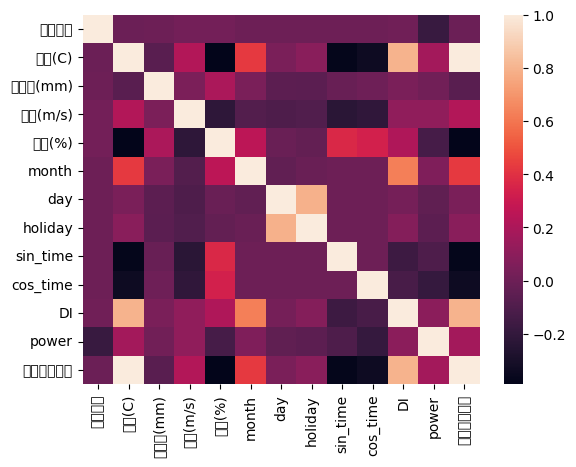

<Figure size 1500x800 with 0 Axes>

In [48]:
sns.heatmap(train.corr())
plt.figure(figsize=(15,8))

In [45]:
train.corr()

,건물번호,기온(C),강수량(mm),풍속(m/s),습도(%),month,day,holiday,sin_time,cos_time,DI,power,적정온도차이
건물번호,1.000000e+00,-0.004505,-0.004135,0.021413,0.022798,-2.790756e-14,-1.518670e-14,-1.169473e-15,-7.064602e-19,8.378550e-18,0.007622,-0.180474,-0.004505
기온(C),-4.504794e-03,1.000000,-0.068643,0.220072,-0.389585,4.271998e-01,4.288145e-02,9.065367e-02,-3.763837e-01,-3.376778e-01,0.797918,0.171190,1.000000
강수량(mm),-4.134622e-03,-0.068643,1.000000,0.048103,0.199491,4.343621e-02,-5.596441e-02,-5.948565e-02,-1.855866e-02,5.276106e-03,0.043212,0.015083,-0.068643
풍속(m/s),2.141270e-02,0.220072,0.048103,1.000000,-0.218568,-8.638854e-02,-1.066293e-01,-9.143451e-02,-2.337166e-01,-2.132944e-01,0.110051,0.109956,0.220072
습도(%),2.279767e-02,-0.389585,0.199491,-0.218568,1.000000,2.537476e-01,-1.339402e-02,-3.362998e-02,3.660243e-01,3.369507e-01,0.211079,-0.129373,-0.389585
month,-2.790756e-14,0.427200,0.043436,-0.086389,0.253748,1.000000e+00,-3.773670e-02,-1.006946e-02,-2.309672e-18,4.189886e-18,0.627768,0.055842,0.427200
day,-1.518670e-14,0.042881,-0.055964,-0.106629,-0.013394,-3.773670e-02,1.000000e+00,7.912646e-01,1.284674e-18,1.614974e-18,0.025724,-0.043600,0.042881
holiday,-1.169473e-15,0.090654,-0.059486,-0.091435,-0.033630,-1.006946e-02,7.912646e-01,1.000000e+00,8.728492e-19,-1.816655e-18,0.072044,-0.057888,0.090654
sin_time,-7.064602e-19,-0.376384,-0.018559,-0.233717,0.366024,-2.309672e-18,1.284674e-18,8.728492e-19,1.000000e+00,-2.970826e-17,-0.164149,-0.104119,-0.376384
cos_time,8.378550e-18,-0.337678,0.005276,-0.213294,0.336951,4.189886e-18,1.614974e-18,-1.816655e-18,-2.970826e-17,1.000000e+00,-0.127569,-0.191212,-0.337678
